<h1>Hotel Booking Demand

<h3>Các thư viện kèm theo

In [23]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

In [24]:
from sklearn.model_selection import train_test_split
from sklearn.dummy import DummyClassifier
from sklearn import tree
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
# from sklearn import preprocessing
from sklearn.neural_network import MLPClassifier
from sklearn import svm
from sklearn.svm import SVC
from sklearn.ensemble import BaggingClassifier
from datetime import datetime, timedelta
from sklearn.model_selection import ShuffleSplit, cross_val_score, train_test_split, KFold, GridSearchCV

In [25]:
import time

In [26]:
import warnings
warnings.filterwarnings("ignore")

In [27]:
# from google.colab import files

In [28]:
from sklearn.datasets import make_classification
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

<h3>Đọc dữ liệu bài toán

<li>Nhập dữ liệu đã làm sạch

In [29]:
df = pd.read_csv("duLieuDaXuLy.csv")

<li>Xem 10 dòng dữ liệu đầu tiên của tập dữ liệu

In [30]:
df.head(10)

,Unnamed: 0,hotel,is_canceled,lead_time,arrival_date_month,adults,meal,market_segment,distribution_channel,is_repeated_guest,...,booking_changes,deposit_type,customer_type,adr,total_of_special_requests,total_nights,party_size,is_family,room_difference,status_minus_arrival_date
0,56778,City Hotel,1,2,9,1,BB,Groups,Direct,0,...,0,No Deposit,Transient-Party,3,0,1,1,0,0,2
1,8382,Resort Hotel,1,3,9,1,BB,Online TA,TA/TO,0,...,0,No Deposit,Transient,2,0,2,1,0,0,3
2,61240,City Hotel,1,3,12,1,BB,Online TA,TA/TO,0,...,2,No Deposit,Transient,2,3,4,1,0,0,3
3,76591,City Hotel,1,4,9,1,HB,Groups,TA/TO,0,...,0,Non Refund,Transient,2,0,2,1,0,0,2
4,12737,Resort Hotel,1,1,7,2,BB,Online TA,TA/TO,0,...,1,No Deposit,Transient,4,0,1,2,0,0,1
5,72864,City Hotel,1,4,8,1,BB,Offline TA/TO,TA/TO,0,...,0,No Deposit,Transient,2,0,2,1,0,0,1
6,61550,City Hotel,1,2,12,1,SC,Online TA,TA/TO,0,...,0,No Deposit,Transient,2,1,2,1,0,0,2
7,54984,City Hotel,1,4,8,1,HB,Online TA,TA/TO,0,...,1,No Deposit,Transient,4,2,4,2,1,0,1
8,43977,City Hotel,1,3,9,1,BB,Groups,TA/TO,0,...,0,Non Refund,Transient,4,0,1,1,0,0,3
9,47668,City Hotel,1,1,2,1,BB,Offline TA/TO,TA/TO,0,...,0,No Deposit,Transient-Party,1,0,2,1,0,0,1


<li>Xem xét dữ liệu ban đầu

In [31]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 88133 entries, 0 to 88132
Data columns (total 22 columns):
 #   Column                          Non-Null Count  Dtype 
---  ------                          --------------  ----- 
 0   Unnamed: 0                      88133 non-null  int64 
 1   hotel                           88133 non-null  object
 2   is_canceled                     88133 non-null  int64 
 3   lead_time                       88133 non-null  int64 
 4   arrival_date_month              88133 non-null  int64 
 5   adults                          88133 non-null  int64 
 6   meal                            88133 non-null  object
 7   market_segment                  88133 non-null  object
 8   distribution_channel            88133 non-null  object
 9   is_repeated_guest               88133 non-null  int64 
 10  previous_cancellations          88133 non-null  int64 
 11  previous_bookings_not_canceled  88133 non-null  int64 
 12  booking_changes                 88133 non-null

<li>Xóa thuộc tính <strong>Unnamed: 0</strong> trong tập dữ liệu


In [32]:
df = df.drop(["Unnamed: 0"], axis = 1)

<li>Tạo datafframe mới dựa trên tập dữ liệu ban đầu

<h3>Khảo sát độ tương đồng giữa các thuộc tính với nhau bằng công thức Pearson. Những cột nào có giá trị tương đồng cao thì hãy loại bỏ.

<li>Tạo hàm lấy các các thuộc tính có độ tương quan cao

In [33]:
def correlation(dataset, threshold):
    col_corr = set() #Tập hợp tất cả các cột tương quan
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold:
                colname = corr_matrix.columns[i]  
                col_corr.add(colname)
    return col_corr

<li>Kết hợp với thư viện biểu diễn đồ thị seaborn để trực quan hóa kết quả bằng đồ thị heatmap.

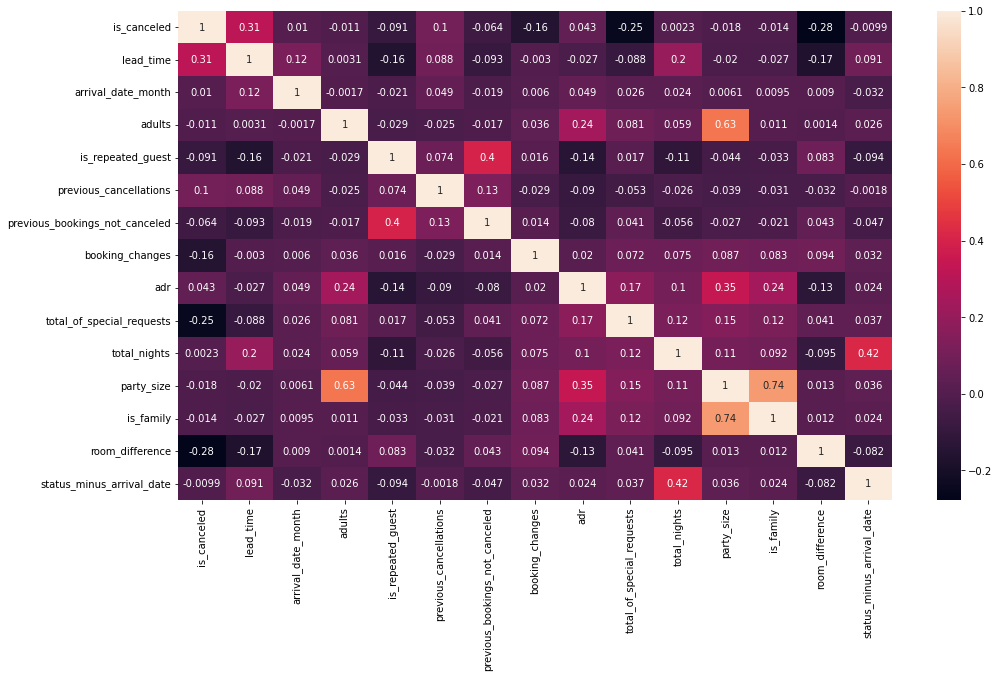

In [34]:
plt.figure(figsize=(16,9))
sns.heatmap(df.corr(method='pearson'),annot=True)
plt.savefig('./Img/corr_heatmap.png')

In [35]:
corr = 0.7

In [36]:
time_bm = []
training_score_bm = []
test_score_bm = []

time_id3 = []
training_score_id3 = []
test_score_id3 = []

time_cart = []
training_score_cart = []
test_score_cart = []

time_nb = []
training_score_nb = []
test_score_nb = []

time_rf = []
training_score_rf = []
test_score_rf = []

time_lr = []
training_score_lr = []
test_score_lr = []

time_knn = []
training_score_knn = []
test_score_knn = []

time_nn = []
training_score_nn = []
test_score_nn = []

time_bc = []
training_score_bc = []
test_score_bc = []

In [37]:
def save_tree_id3(id3, i, corr):
  fig, ax = plt.subplots(figsize=(50,24))
  tree.plot_tree(id3,filled=True,fontsize=10)
  plt.savefig('./Img/Tree/DecisionTreeID3_{0}_{1}.png'.format(corr, i))

In [38]:
def save_tree_cart(cart, i, corr):
  fig, ax = plt.subplots(figsize=(50,24))
  tree.plot_tree(cart,filled=True,fontsize=10)
  plt.savefig('./Img/Tree/DecisionTreeCart_{0}_{1}.png'.format(corr, i))

In [39]:
def save_randomForest(rf, i, corr, x_train):
  fig, ax = plt.subplots(figsize=(50,24))
  tree.plot_tree(rf.estimators_[0], filled=True)
  plt.savefig('./Img/Tree/RandomForest_{0}_{1}.png'.format(corr, i))

In [40]:
def Roc_Img(bm, id3, cart, nb, rf, lr, knn, nn, bc, x_test, y_test, corr, i):
    plt.figure(figsize=(24,12))
    bm_probs = bm.predict_proba(x_test)
    bm_probs = bm_probs[:, 1]
    bm_auc = roc_auc_score(y_test, bm_probs)
    print('No Skill: ROC AUC=%.3f' % (bm_auc))
    bm_fpr, bm_tpr, _ = roc_curve(y_test, bm_probs)
    plt.plot(bm_fpr, bm_tpr, linestyle='--', label='No Skill')

    id3_probs = id3.predict_proba(x_test)
    id3_probs = id3_probs[:, 1]
    id3_auc = roc_auc_score(y_test, id3_probs)
    print('Decision Tree ID3: ROC AUC=%.3f' % (id3_auc))
    id3_fpr, id3_tpr, _ = roc_curve(y_test, id3_probs)
    plt.plot(id3_fpr, id3_tpr, linestyle='--', label='Decision Tree ID3')

    cart_probs = cart.predict_proba(x_test)
    cart_probs = cart_probs[:, 1]
    cart_auc = roc_auc_score(y_test, cart_probs)
    print('Decision Tree Cart: ROC AUC=%.3f' % (cart_auc))
    cart_fpr, cart_tpr, _ = roc_curve(y_test, cart_probs)
    plt.plot(cart_fpr, cart_tpr, linestyle='--', label='Decision Tree Cart')

    nb_probs = nb.predict_proba(x_test)
    nb_probs = nb_probs[:, 1]
    nb_auc = roc_auc_score(y_test, nb_probs)
    print('Naive Bayes: ROC AUC=%.3f' % (nb_auc))
    nb_fpr, nb_tpr, _ = roc_curve(y_test, nb_probs)
    plt.plot(nb_fpr, nb_tpr, linestyle='--', label='Naive Bayes')

    rf_probs = rf.predict_proba(x_test)
    rf_probs = rf_probs[:, 1]
    rf_auc = roc_auc_score(y_test, rf_probs)
    print('Random Forest: ROC AUC=%.3f' % (rf_auc))
    rf_fpr, rf_tpr, _ = roc_curve(y_test, rf_probs)
    plt.plot(rf_fpr, rf_tpr, linestyle='--', label='Random Forest')

    lr_probs = lr.predict_proba(x_test)
    lr_probs = lr_probs[:, 1]
    lr_auc = roc_auc_score(y_test, lr_probs)
    print('Logistic Regression: ROC AUC=%.3f' % (lr_auc))
    lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
    plt.plot(lr_fpr, lr_tpr, linestyle='--', label='Logistic Regression')

    knn_probs = knn.predict_proba(x_test)
    knn_probs = knn_probs[:, 1]
    knn_auc = roc_auc_score(y_test, knn_probs)
    print('K Nearest Neighbors ROC AUC=%.3f' % (knn_auc))
    knn_fpr, knn_tpr, _ = roc_curve(y_test, knn_probs)
    plt.plot(knn_fpr, knn_tpr, linestyle='--', label='K Nearest Neighbors')

    nn_probs = nn.predict_proba(x_test)
    nn_probs = nn_probs[:, 1]
    nn_auc = roc_auc_score(y_test, nn_probs)
    print('Neural Network: ROC AUC=%.3f' % (nn_auc))
    nn_fpr, nn_tpr, _ = roc_curve(y_test, nn_probs)
    plt.plot(nn_fpr, nn_tpr, linestyle='--', label='Neural Network')

    bc_probs = bc.predict_proba(x_test)
    bc_probs = bc_probs[:, 1]
    bc_auc = roc_auc_score(y_test, bc_probs)
    print('Bagging Classifier: ROC AUC=%.3f' % (bc_auc))
    bc_fpr, bc_tpr, _ = roc_curve(y_test, bc_probs)
    plt.plot(bc_fpr, bc_tpr, linestyle='--', label='Bagging Classifier')

    # axis labels
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend()
    plt.savefig('./Img/Roc/{0}_{1}.png'.format(corr, i))

In [41]:
def get_score(x_train, x_test, y_train, y_test, i, corr):
  print("-----Baseline Model-----")
  start= time.time()
  bm = DummyClassifier(strategy='most_frequent', random_state=0)
  bm.fit(x_train, y_train)
  end = time.time()
  time_bm.append(end - start)
  training_score_bm.append(bm.score(x_train, y_train))
  bm_pred = bm.predict(x_test)
  bm_score = metrics.accuracy_score(y_test, bm_pred)
  test_score_bm.append(bm_score)
  print("Baseline Model")
  print("Accruracy:",bm_score)
  print("Report:",metrics.classification_report(y_test,bm_pred))
  bm_cm = metrics.confusion_matrix(y_test,bm_pred)
  
  print("-----Decision Tree ID3-----")
  start= time.time()
  id3 = tree.DecisionTreeClassifier(criterion="entropy",random_state=0)
  id3.fit(x_train,y_train)
  end = time.time()
  time_id3.append(end - start)
  training_score_id3.append(id3.score(x_train, y_train))
  id3_pred = id3.predict(x_test)
  id3_score = metrics.accuracy_score(y_test, id3_pred)
  test_score_id3.append(id3_score)
  print("Decision Tree ID3")
  print("Accruracy:",id3_score)
  print("Report:",metrics.classification_report(y_test,id3_pred))
  id3_cm = metrics.confusion_matrix(y_test,id3_pred)
  save_tree_id3(id3, i, corr)
  
  print("-----Decision Tree Cart-----")
  start= time.time()
  cart = tree.DecisionTreeClassifier(criterion="gini",random_state=0)
  cart.fit(x_train,y_train)
  end = time.time()
  time_cart.append(end - start)
  training_score_cart.append(cart.score(x_train, y_train))
  cart_pred = cart.predict(x_test)
  cart_score = metrics.accuracy_score(y_test, cart_pred)
  test_score_cart.append(cart_score)
  print("Decision Tree Cart")
  print("Accruracy:",cart_score)
  print("Report:",metrics.classification_report(y_test,cart_pred))
  cart_cm = metrics.confusion_matrix(y_test,cart_pred)
  save_tree_cart(cart, i, corr)
  
  print("-----Naive Bayes-----")
  start= time.time()
  nb = GaussianNB()
  nb.fit(x_train,y_train)
  end = time.time()
  time_nb.append(end - start)
  training_score_nb.append(nb.score(x_train, y_train))
  nb_pred = nb.predict(x_test)
  nb_score = metrics.accuracy_score(y_test, nb_pred)
  test_score_nb.append(nb_score)
  print("Naive Bayes")
  print("Accruracy:",nb_score)
  print("Report:",metrics.classification_report(y_test,nb_pred))
  nb_cm = metrics.confusion_matrix(y_test,nb_pred)
  
  print("-----Random Forest-----")
  start= time.time()
  rf = RandomForestClassifier()
  rf.fit(x_train,y_train)
  end = time.time()
  time_rf.append(end - start)
  training_score_rf.append(rf.score(x_train, y_train))
  rf_pred = rf.predict(x_test)
  rf_score = metrics.accuracy_score(y_test, rf_pred)
  test_score_rf.append(rf_score)
  print("Random Forest")
  print("Accruracy:",rf_score)
  print("Report:",metrics.classification_report(y_test,rf_pred))
  rf_cm = metrics.confusion_matrix(y_test,rf_pred)
  save_randomForest(rf, i, corr, x_train)
  
  print("-----Logistic Regression-----")
  start= time.time()
  lr = LogisticRegression()
  lr.fit(x_train,y_train)
  end = time.time()
  time_lr.append(end - start)
  training_score_lr.append(lr.score(x_train, y_train))
  lr_pred = lr.predict(x_test)
  lr_score = metrics.accuracy_score(y_test, lr_pred)
  test_score_lr.append(lr_score)
  print("Logistic Regression")
  print("Accruracy:",lr_score)
  print("Report:",metrics.classification_report(y_test,lr_pred))
  lr_cm = metrics.confusion_matrix(y_test,lr_pred)
  
  print("-----K-Nearest Neighbor-----")
  start= time.time()
  knn = KNeighborsClassifier()
  knn.fit(x_train,y_train)
  end = time.time()
  time_knn.append(end - start)
  training_score_knn.append(knn.score(x_train, y_train))
  knn_pred = knn.predict(x_test)
  knn_score = metrics.accuracy_score(y_test, knn_pred)
  test_score_knn.append(knn_score)
  print("K-Nearest Neighbor")
  print("Accruracy:",knn_score)
  print("Report:",metrics.classification_report(y_test,knn_pred))
  knn_cm = metrics.confusion_matrix(y_test,knn_pred)
  
  print("-----Neural Network-----")
  start= time.time()
  nn = MLPClassifier(random_state=0, activation="logistic", solver="sgd")
  nn.fit(x_train,y_train)
  end = time.time()
  time_nn.append(end - start)
  training_score_nn.append(nn.score(x_train, y_train))
  nn_pred = nn.predict(x_test)
  nn_score = metrics.accuracy_score(y_test, nn_pred)
  test_score_nn.append(nn_score)
  print("Neural Network")
  print("Accruracy:",nn_score)
  print("Report:",metrics.classification_report(y_test,nn_pred))
  nn_cm = metrics.confusion_matrix(y_test,nn_pred)
  
  
  print("-----Bagging Classifier-----")
  start= time.time()
  bc = BaggingClassifier(random_state=0)
  bc.fit(x_train,y_train)
  end = time.time()
  time_bc.append(end - start)
  training_score_bc.append(bc.score(x_train, y_train))
  bc_pred = bc.predict(x_test)
  bc_score = metrics.accuracy_score(y_test, bc_pred)
  test_score_bc.append(bc_score)
  print("Bagging Classifier")
  print("Accruracy:",bc_score)
  print("Report:",metrics.classification_report(y_test,bc_pred))
  bc_cm = metrics.confusion_matrix(y_test,bc_pred)

  plt.figure(figsize=(24,12))

  plt.suptitle("Confusion Matrixes",fontsize=24)
  plt.subplots_adjust(wspace = 0.4, hspace= 0.4)

  plt.subplot(5,2,1)
  plt.title("Baseline Confusion Matrix")
  sns.heatmap(bm_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,2)
  plt.title("Decision Tree ID3 Classifier Confusion Matrix")
  sns.heatmap(id3_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,3)
  plt.title("Decision Tree Cart Classifier Confusion Matrix")
  sns.heatmap(cart_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,4)
  plt.title("Naive Bayes Confusion Matrix")
  sns.heatmap(nb_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,5)
  plt.title("Random Forest Confusion Matrix")
  sns.heatmap(rf_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,6)
  plt.title("Logistic Regression Confusion Matrix")
  sns.heatmap(lr_cm, annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,7)
  plt.title("K Nearest Neighbors Confusion Matrix")
  sns.heatmap(knn_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,8)
  plt.title("Neural Network Confusion Matrix")
  sns.heatmap(nn_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,9)
  plt.title("Bagging Classifier Confusion Matrix")
  sns.heatmap(bc_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.savefig('./Img/ConfusionMatrix/{0}_{1}.png'.format(corr, i))
  
  Roc_Img(bm, id3, cart, nb, rf, lr, knn, nn, bc, x_test, y_test, corr, i)

-------------With corr equal: 0.7-------------
Length of corr_feature equal: 1
---------Time: 1---------
-----Baseline Model-----
Baseline Model
Accruracy: 0.5021936459909229
Report:               precision    recall  f1-score   support

           0       0.50      1.00      0.67     13278
           1       0.00      0.00      0.00     13162

    accuracy                           0.50     26440
   macro avg       0.25      0.50      0.33     26440
weighted avg       0.25      0.50      0.34     26440

-----Decision Tree ID3-----
Decision Tree ID3
Accruracy: 0.8872919818456884
Report:               precision    recall  f1-score   support

           0       0.87      0.91      0.89     13278
           1       0.90      0.86      0.88     13162

    accuracy                           0.89     26440
   macro avg       0.89      0.89      0.89     26440
weighted avg       0.89      0.89      0.89     26440

-----Decision Tree Cart-----
Decision Tree Cart
Accruracy: 0.8863086232980333
R

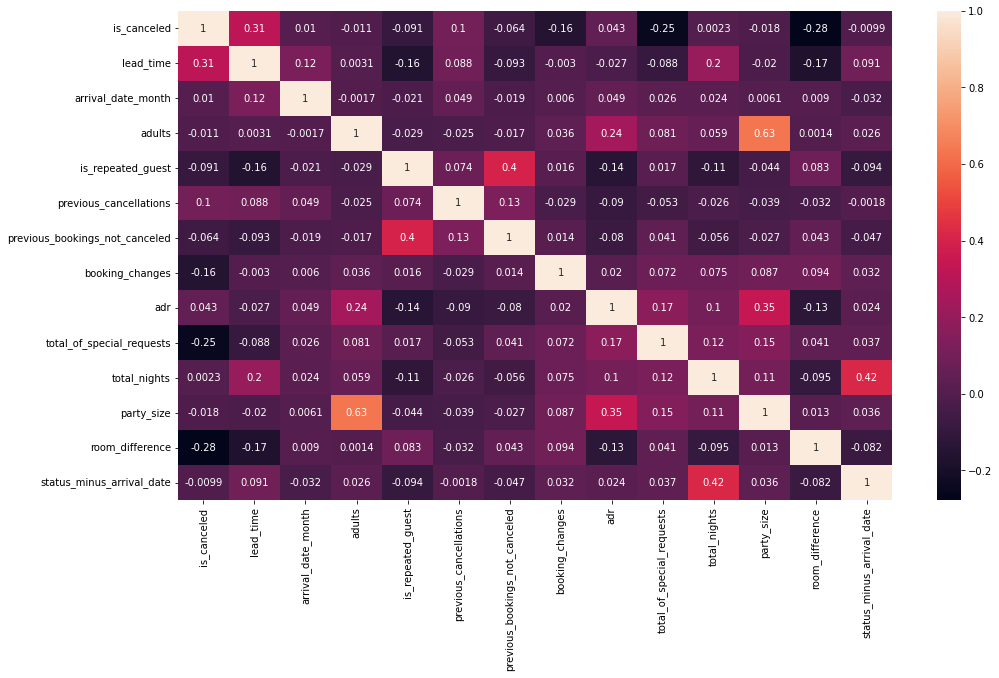

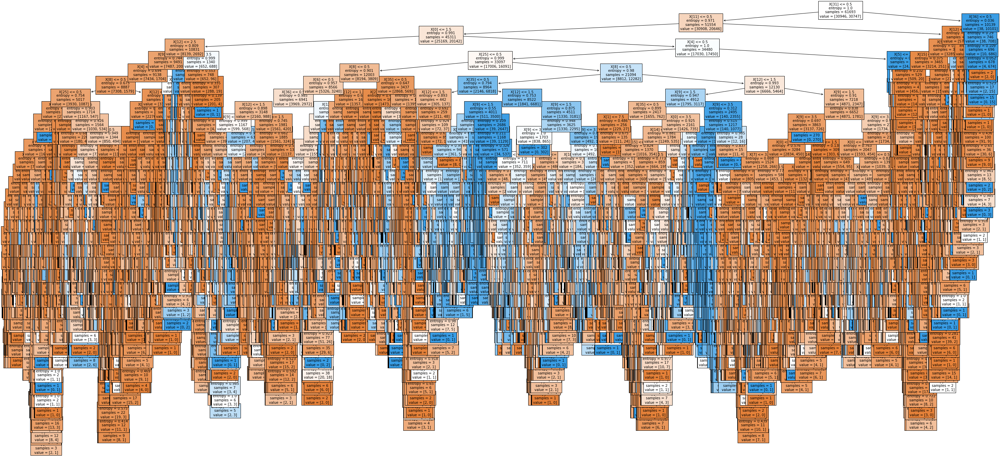

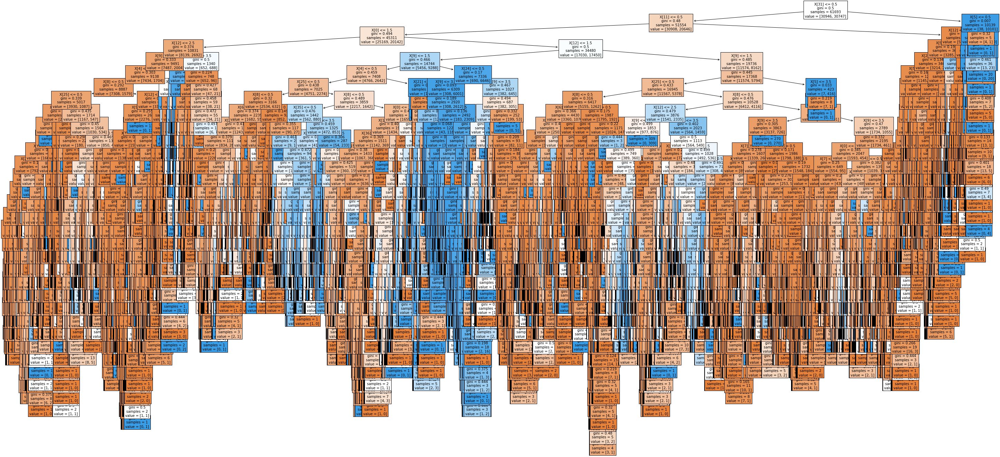

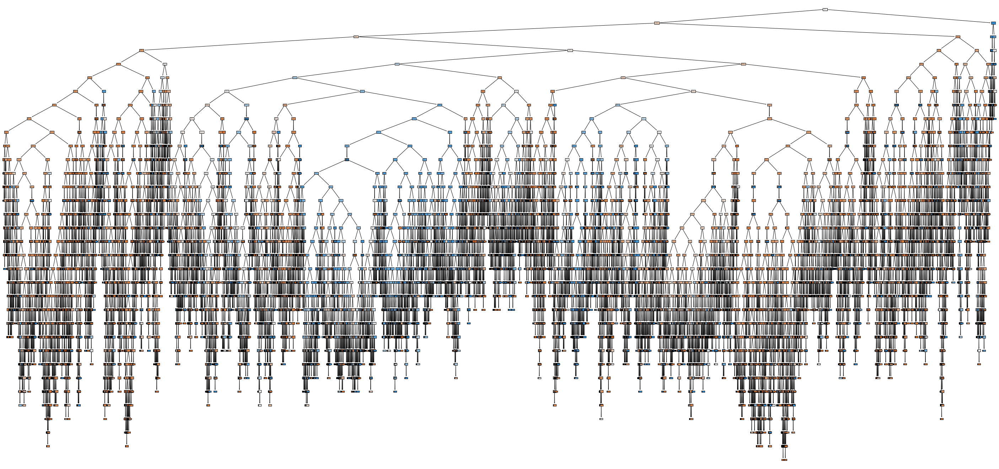

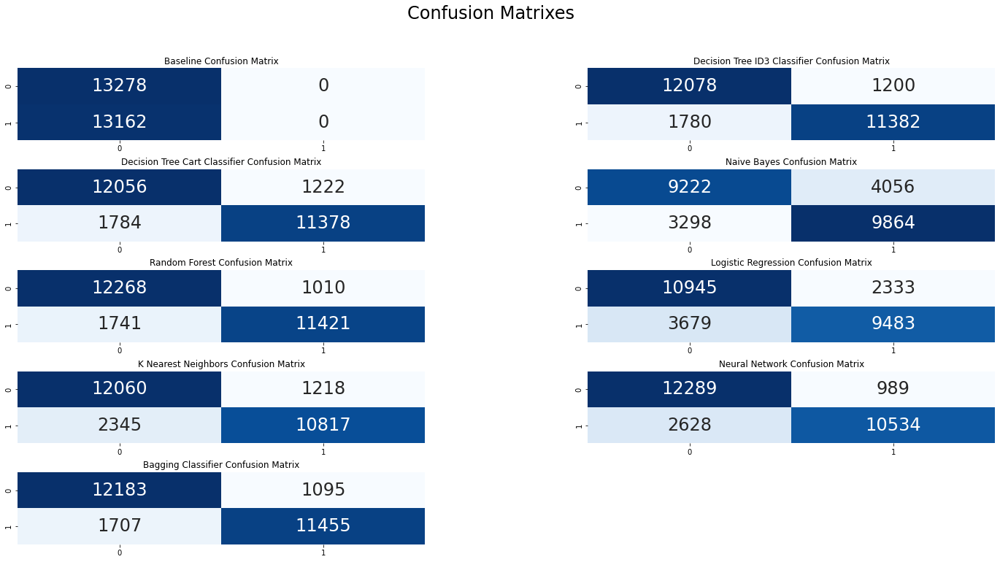

...

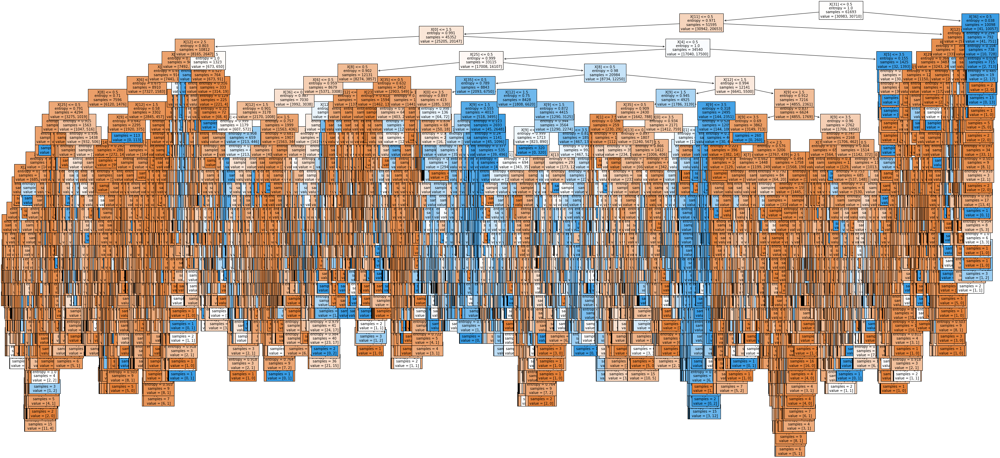

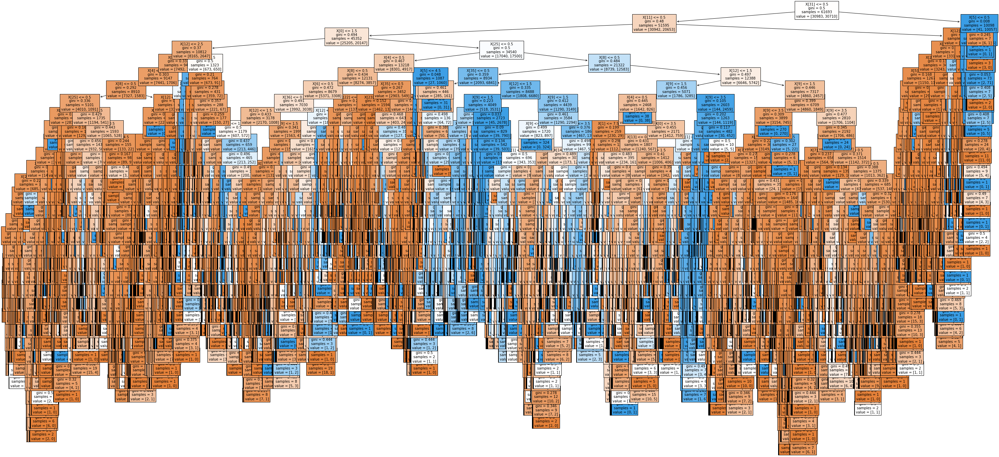

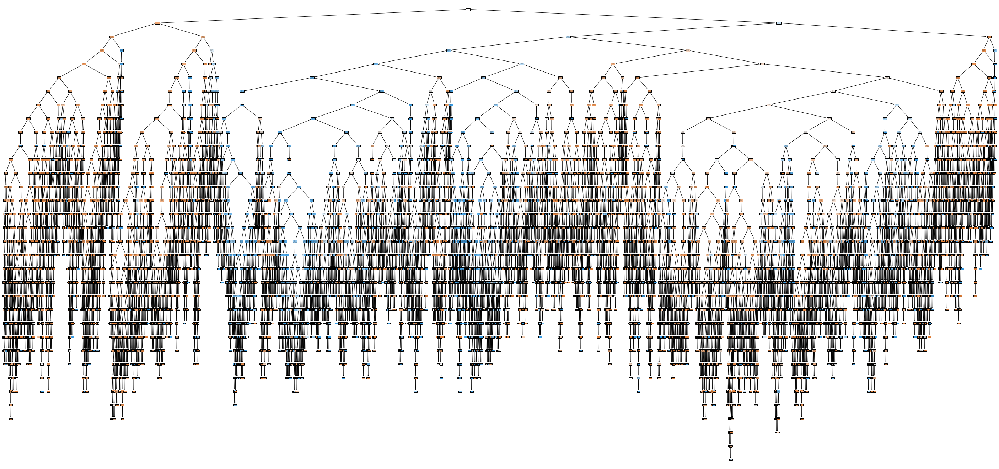

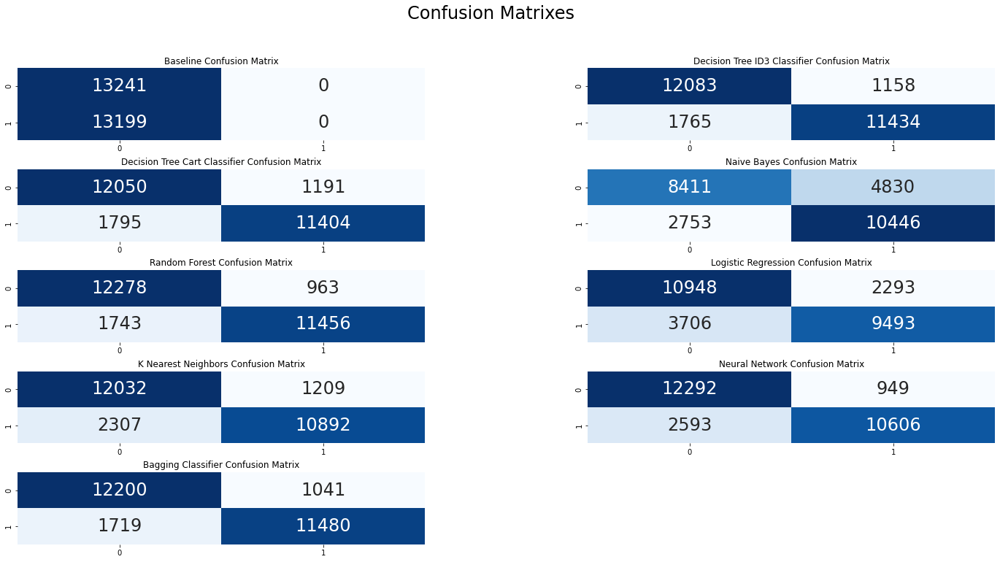

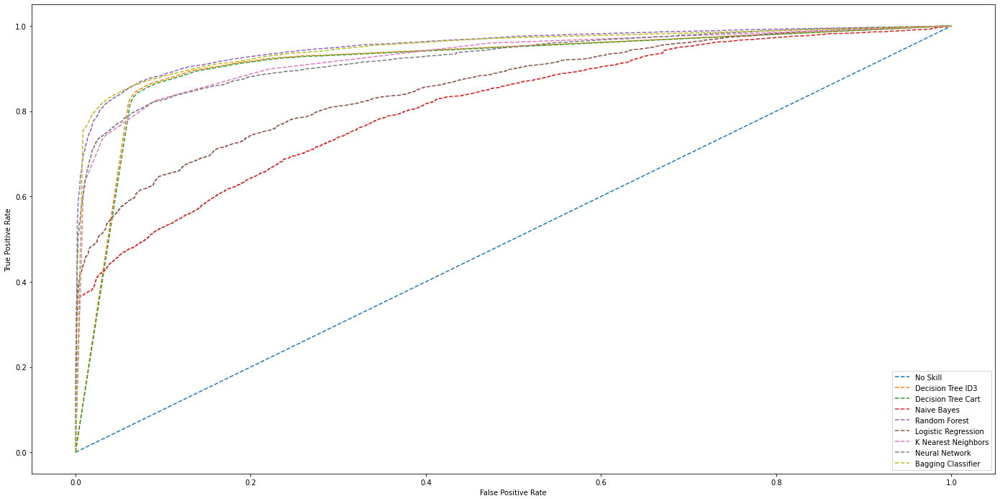

In [42]:
  df1 = df.copy()
  corr_features = correlation(df1, corr)
  print("-------------With corr equal: {0}-------------".format(corr))
  print("Length of corr_feature equal: {0}".format(len(set(corr_features)))) 
  df1 = df1.drop(corr_features, axis = 1)
  plt.figure(figsize=(16,9))
  sns.heatmap(df1.corr(method='pearson'),annot=True)
  plt.savefig('./Img/corr_heatmap_{0}.png'.format(corr))
  feature = df1.drop('is_canceled',axis=1)
  label = df1['is_canceled']
  feature_onehot = pd.get_dummies(feature,columns=feature.select_dtypes(exclude=['int64']).columns) 
  folds = ShuffleSplit(n_splits=7, random_state=42, test_size=0.3)
  feature_onehot = np.array(feature_onehot)
  label = np.array(label)
  i = 1
  for train_index, test_index  in folds.split(label):
    print("---------Time: {}---------".format(i))
    x_train, x_test = feature_onehot[train_index], feature_onehot[test_index]
    y_train, y_test = label[train_index], label[test_index]
    get_score(x_train, x_test, y_train, y_test, i, corr)
    i = i + 1


In [43]:
print("-----------------1. Baseline Model-----------------")
print("Time: {}".format(time_bm))
print("Training Acurracy: {}".format(training_score_bm))
print("Test Acurracy: {}".format(test_score_bm))

-----------------1. Baseline Model-----------------
Time: [0.002000570297241211, 0.0029990673065185547, 0.002001047134399414, 0.0, 0.0, 0.003000974655151367, 0.0030007362365722656]
Training Acurracy: [0.5016128247937367, 0.5001864068857083, 0.5010292901949979, 0.5026988475191675, 0.5020342664483814, 0.5033148007067252, 0.502212568686885]
Test Acurracy: [0.5021936459909229, 0.49360816944024205, 0.5035552193645991, 0.49965960665658093, 0.5012102874432678, 0.49822239031770044, 0.5007942511346445]


In [44]:
print("-----------------2. Decision Tree ID3-----------------")
print("Time: {}".format(time_id3))
print("Training Acurracy: {}".format(training_score_id3))
print("Test Acurracy: {}".format(test_score_id3))


-----------------2. Decision Tree ID3-----------------
Time: [0.27295398712158203, 0.3063347339630127, 0.29895734786987305, 0.30563807487487793, 0.2700920104980469, 0.3172469139099121, 0.3315589427947998]
Training Acurracy: [0.9509182565282933, 0.9504157684016015, 0.9503671405183732, 0.9508372100562462, 0.9512910702997098, 0.9504806055792392, 0.9502698847519168]
Test Acurracy: [0.8872919818456884, 0.8925491679273827, 0.8888804841149773, 0.8898260211800303, 0.8863464447806354, 0.8889183055975795, 0.8894478063540091]


In [45]:
print("-----------------3. Decision Tree Cart-----------------")
print("Time: {}".format(time_cart))
print("Training Acurracy: {}".format(training_score_cart))
print("Test Acurracy: {}".format(test_score_cart))


-----------------3. Decision Tree Cart-----------------
Time: [0.3021507263183594, 0.2714669704437256, 0.2900216579437256, 0.2922329902648926, 0.26747679710388184, 0.2848803997039795, 0.32079339027404785]
Training Acurracy: [0.9509182565282933, 0.9504157684016015, 0.9503671405183732, 0.9508372100562462, 0.9512910702997098, 0.9504806055792392, 0.9502698847519168]
Test Acurracy: [0.8863086232980333, 0.8885022692889561, 0.8880862329803328, 0.8899773071104388, 0.8854009077155824, 0.8889939485627837, 0.8870650529500756]


In [46]:
print("-----------------4. Naive Bayes-----------------")
print("Time: {}".format(time_nb))
print("Training Acurracy: {}".format(training_score_nb))
print("Test Acurracy: {}".format(test_score_nb))


-----------------4. Naive Bayes-----------------
Time: [0.03748369216918945, 0.03453850746154785, 0.03500771522521973, 0.0400090217590332, 0.03528189659118652, 0.03600955009460449, 0.03930068016052246]
Training Acurracy: [0.7204220900264211, 0.7214432755742143, 0.7181203702202843, 0.7200816948438234, 0.7210542525083883, 0.7160455805358793, 0.714862302043992]
Test Acurracy: [0.7218608169440242, 0.7194402420574887, 0.7214069591527988, 0.7177004538577912, 0.7244326777609682, 0.7142965204236006, 0.7131996974281392]


In [47]:
print("-----------------5. Random Forest-----------------")
print("Time: {}".format(time_rf))
print("Training Acurracy: {}".format(training_score_rf))
print("Test Acurracy: {}".format(test_score_rf))

-----------------5. Random Forest-----------------
Time: [5.702978134155273, 5.578057527542114, 4.934349298477173, 5.611364364624023, 5.3079094886779785, 4.8998167514801025, 5.245392084121704]
Training Acurracy: [0.9509182565282933, 0.9503833498127826, 0.9503671405183732, 0.9508372100562462, 0.9512910702997098, 0.9504481869904203, 0.9502698847519168]
Test Acurracy: [0.8959531013615734, 0.8984871406959153, 0.8987518910741301, 0.8988653555219365, 0.8941376701966717, 0.8979576399394856, 0.8976550680786687]


In [48]:
print("-----------------6. Logistic Regression-----------------")
print("Time: {}".format(time_lr))
print("Training Acurracy: {}".format(training_score_lr))
print("Test Acurracy: {}".format(test_score_lr))


-----------------6. Logistic Regression-----------------
Time: [0.507796049118042, 0.41650915145874023, 0.4626154899597168, 0.6307170391082764, 0.41890525817871094, 0.4151759147644043, 0.48511219024658203]
Training Acurracy: [0.7743990404097709, 0.7715299952993047, 0.7737668779278039, 0.7742855753489051, 0.774480086881818, 0.7721783670756812, 0.7751770865414228]
Test Acurracy: [0.7726172465960666, 0.7751512859304085, 0.7738275340393344, 0.7737518910741301, 0.7712556732223903, 0.7739409984871407, 0.7731089258698941]


In [49]:
print("-----------------7. K-Nearest Neighbor-----------------")
print("Time: {}".format(time_knn))
print("Training Acurracy: {}".format(training_score_knn))
print("Test Acurracy: {}".format(test_score_knn))


-----------------7. K-Nearest Neighbor-----------------
Time: [0.0029997825622558594, 0.0030007362365722656, 0.0040013790130615234, 0.0030007362365722656, 0.0029997825622558594, 0.0, 0.003999471664428711]
Training Acurracy: [0.9024038383609162, 0.9020796524727278, 0.9015285364628077, 0.9017878851733584, 0.9028576986043797, 0.9014474899907607, 0.900442513737377]
Test Acurracy: [0.8652420574886536, 0.8659228441754917, 0.8677004538577913, 0.8673222390317701, 0.8664901664145235, 0.8672465960665658, 0.8670196671709531]


In [50]:
print("-----------------8. Neural Network-----------------")
print("Time: {}".format(time_nn))
print("Training Acurracy: {}".format(training_score_nn))
print("Test Acurracy: {}".format(test_score_nn))

-----------------8. Neural Network-----------------
Time: [68.23479127883911, 63.547998905181885, 64.85478210449219, 79.68084406852722, 66.00604367256165, 70.98407983779907, 72.09988474845886]
Training Acurracy: [0.8679590877409107, 0.8645713452093431, 0.8658032515844585, 0.8663057397111503, 0.865819460878868, 0.8649765775695784, 0.8668082278378422]
Test Acurracy: [0.8631996974281392, 0.8707261724659606, 0.8676626323751891, 0.866641452344932, 0.8662632375189108, 0.8681164901664146, 0.8660363086232981]


In [51]:
print("-----------------9. Bagging Classifier-----------------")
print("Time: {}".format(time_bc))
print("Training Acurracy: {}".format(training_score_bc))
print("Test Acurracy: {}".format(test_score_bc))


-----------------9. Bagging Classifier-----------------
Time: [2.2536509037017822, 1.9312925338745117, 1.8295001983642578, 2.520801305770874, 2.086010217666626, 2.0738766193389893, 2.012706756591797]
Training Acurracy: [0.9472225374029468, 0.9464120726824762, 0.9467362585706645, 0.9468497236315303, 0.9475629325855446, 0.946720049276255, 0.9466876306874362]
Test Acurracy: [0.8940242057488653, 0.8976928895612708, 0.8970499243570348, 0.8973146747352496, 0.8937594553706505, 0.8958774583963691, 0.8956127080181543]


<h3>Phân tích đánh giá các thuật toán và dự báo

In [52]:
def mean(lst):
    return sum(lst) / len(lst)

<li>Đánh giá thời gian chạy của thuật toán

In [53]:
df_time = pd.DataFrame(data=[('Baseline',mean(time_bm)), ('Decision Tree ID3',mean(time_id3)), ('Decision Tree Cart',mean(time_cart)), 
                             ('Naive Bayes',mean(time_nb)), ('Random Forest',mean(time_rf)), ('Logistic Regression',mean(time_lr)), 
                             ('K-Nearest Neighbor',mean(time_knn)), ('Neural Network',mean(time_nn)), 
                             ('Bagging Classifier',mean(time_bc))],
                                       columns=['Model', 'Time'])

In [54]:
df_time

,Model,Time
0,Baseline,0.001857
1,Decision Tree ID3,0.300397
2,Decision Tree Cart,0.289860
3,Naive Bayes,0.036804
4,Random Forest,5.325695
5,Logistic Regression,0.476690
6,K-Nearest Neighbor,0.002857
7,Neural Network,69.344061
8,Bagging Classifier,2.101120


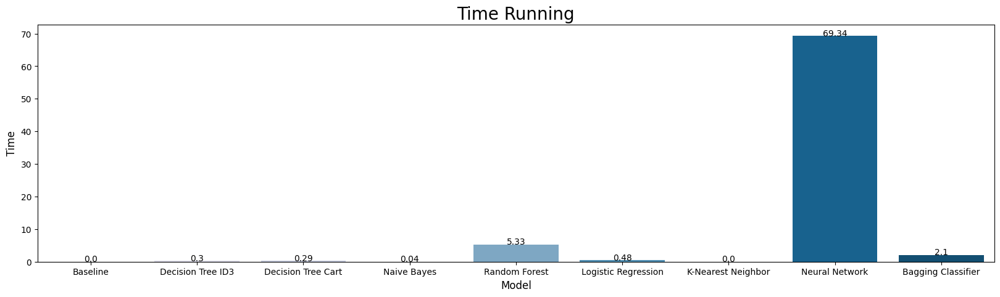

In [55]:
plt.style.use('default')
plt.figure(figsize=(20,5))
p=sns.barplot(x='Model', y='Time', data=df_time, palette='PuBu')
plt.title('Time Running', fontsize = 20)
plt.xlabel('Model', fontsize = 12)
plt.ylabel('Time', fontsize = 12)
for index, row in df_time.iterrows():
    p.text(x=row.name, y=row.Time, s=round(row.Time,2), color='black', horizontalalignment='center');

<strong>Kết luận:</strong>


*   Thời gian chạy của thuật toán KNN nhanh nhất khi loại bỏ mô hình Baseline. (giống với tập data trước)
*   Thời gian chạy của thuật toán Neural Network chậm nhất trong tất cả các thuật toán. (thời gian chạy gần như gấp đôi)



<li>Đánh giá độ chính xác của thuật toán

<strong>Độ chính xác của tập dữ liệu đào tạo

In [56]:
df_train = pd.DataFrame(data=[('Baseline',mean(training_score_bm)), ('Decision Tree ID3',mean(training_score_id3)), ('Decision Tree Cart',mean(training_score_cart)), 
                             ('Naive Bayes',mean(training_score_nb)), ('Random Forest',mean(training_score_rf)), ('Logistic Regression',mean(training_score_lr)), 
                             ('K-Nearest Neighbor',mean(training_score_knn)), ('Neural Network',mean(training_score_nn)), 
                             ('Bagging Classifier',mean(training_score_bc))],
                                       columns=['Model', 'Accuracy'])

In [57]:
df_train

,Model,Accuracy
0,Baseline,0.501870
1,Decision Tree ID3,0.950654
2,Decision Tree Cart,0.950654
3,Naive Bayes,0.718861
4,Random Forest,0.950645
5,Logistic Regression,0.773688
6,K-Nearest Neighbor,0.901793
7,Neural Network,0.866035
8,Bagging Classifier,0.946884


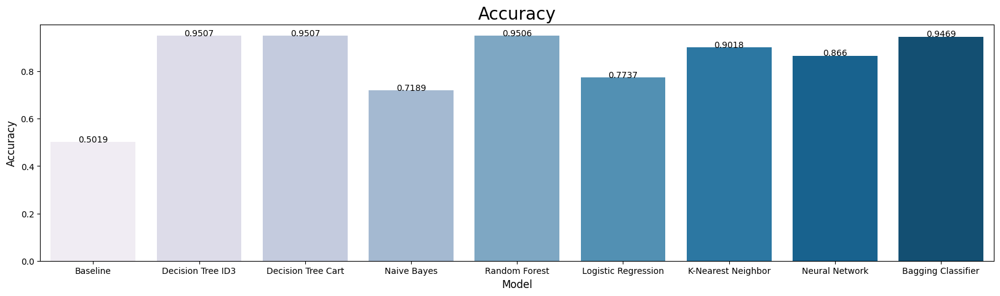

In [58]:
plt.style.use('default')
plt.figure(figsize=(20,5))
p=sns.barplot(x='Model', y='Accuracy', data=df_train, palette='PuBu')
plt.title('Accuracy', fontsize = 20)
plt.xlabel('Model', fontsize = 12)
plt.ylabel('Accuracy', fontsize = 12)
for index, row in df_train.iterrows():
    p.text(x=row.name, y=row.Accuracy, s=round(row.Accuracy,4), color='black', horizontalalignment='center');

<strong>Kết luận:</strong>


*   Độ chính xác hai mô hình Decision Tree cao nhất so với các mô hình còn lại. Mô hình Random Forest có độ chính xác nhiều hơn ban đầu, chỉ kém hơn Decision Tree 0.0001.
*   Độ chính xác của Naive Bayes là thấy nhất khi loại trừ Baseline Model.(Nhưng cao hơn, gần bằng độ chính xác của Logistic Regression)


<strong>Độ hính xác của tập dữ liệu kiểm tra

In [59]:
df_test = pd.DataFrame(data=[('Baseline',mean(test_score_bm)), ('Decision Tree ID3',mean(test_score_id3)), ('Decision Tree Cart',mean(test_score_cart)), 
                             ('Naive Bayes',mean(test_score_nb)), ('Random Forest',mean(test_score_rf)), ('Logistic Regression',mean(test_score_lr)), 
                             ('K-Nearest Neighbor',mean(test_score_knn)), ('Neural Network',mean(test_score_nn)), 
                             ('Bagging Classifier',mean(test_score_bc))],
                                       columns=['Model', 'Accuracy'])

In [60]:
df_test

,Model,Accuracy
0,Baseline,0.499892
1,Decision Tree ID3,0.889037
2,Decision Tree Cart,0.887762
3,Naive Bayes,0.718905
4,Random Forest,0.897401
5,Logistic Regression,0.773379
6,K-Nearest Neighbor,0.866706
7,Neural Network,0.866949
8,Bagging Classifier,0.895904


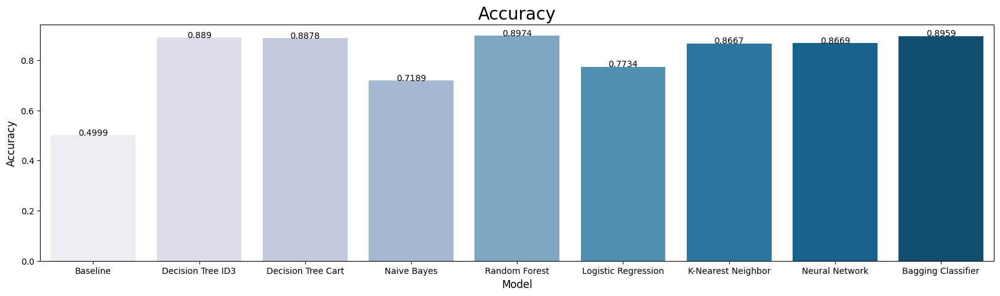

In [61]:
plt.style.use('default')
plt.figure(figsize=(20,5))
p=sns.barplot(x='Model', y='Accuracy', data=df_test, palette='PuBu')
plt.title('Accuracy', fontsize = 20)
plt.xlabel('Model', fontsize = 12)
plt.ylabel('Accuracy', fontsize = 12)
for index, row in df_test.iterrows():
    p.text(x=row.name, y=row.Accuracy, s=round(row.Accuracy,4), color='black', horizontalalignment='center');

<strong>Kết luận:</strong>


*   Độ chính xác khi tiến hành kiểm tra của Random Forest cao hơn so với mô hình Decision Tree đã huấn luyện.
*   Tương tự trong mô hình huấn luyện,mô hình Naive Bayes vẫn có độ chính xác thấp nhất.

